In [1]:
import numpy as np
import pandas as pd
import datetime as dt
from plotly.subplots import make_subplots
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sns
from matplotlib import pyplot as plt

import hvplot.pandas


In [2]:
url = 'https://raw.githubusercontent.com/owid/covid-19-data/master/public/data/owid-covid-data.csv'
data = pd.read_csv(url)
data['date'] = pd.to_datetime(data['date']).dt.date
datafilled = data.fillna(0)

In [176]:
continents=["OWID_AFR","OWID_EUR","OWID_ASI","OWID_NAM","OWID_OCE","OWID_SAM"] 
cont_data = data.loc[data["iso_code"].isin(continents)]


,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,...,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,population,excess_mortality_cumulative_absolute,excess_mortality_cumulative,excess_mortality,excess_mortality_cumulative_per_million
1165,OWID_AFR,NaN,Africa,2020-01-03,NaN,0.0,NaN,NaN,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,1.426737e+09,NaN,NaN,NaN,NaN
1166,OWID_AFR,NaN,Africa,2020-01-04,NaN,0.0,NaN,NaN,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,1.426737e+09,NaN,NaN,NaN,NaN
1167,OWID_AFR,NaN,Africa,2020-01-05,NaN,0.0,NaN,NaN,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,1.426737e+09,NaN,NaN,NaN,NaN
1168,OWID_AFR,NaN,Africa,2020-01-06,NaN,0.0,NaN,NaN,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,1.426737e+09,NaN,NaN,NaN,NaN
1169,OWID_AFR,NaN,Africa,2020-01-07,NaN,0.0,NaN,NaN,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,1.426737e+09,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
245138,OWID_SAM,NaN,South America,2023-03-10,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,4.368167e+08,NaN,NaN,NaN,NaN
245139,OWID_SAM,NaN,South America,2023-03-11,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,4.368167e+08,NaN,NaN,NaN,NaN
245140,OWID_SAM,NaN,South America,2023-03-12,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,4.368167e+08,NaN,NaN,NaN,NaN
245141,OWID_SAM,NaN,South America,2023-03-13,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,4.368167e+08,NaN,NaN,NaN,NaN


In [16]:
mean = data.loc[:,["date","location","total_cases_per_million"]]
mean['date'] = pd.to_datetime(mean['date'])
mean = mean.groupby(['location', mean["date"].dt.to_period('m')]).mean().reset_index()

In [ ]:
df = data.loc[data["continent"]!=0]
fig = px.scatter_geo(df,
                     locations="location",
                     locationmode="country names",
                     size="total_cases_per_million",
                     color_discrete_sequence=["red"],
                     animation_frame='date',
                     )
fig.update_geos(showcountries=True,scope='europe')
fig.update_layout(title="Total cases by country (cases/million ppl)",
                  title_x=0.5,
                  margin={"r":0,"t":50,"l":0,"b":0},
                  height=600,
                  )
fig.show()

In [21]:
total_test_data = data.loc[data["date"]==dt.date(2022,1,1)].ffill()
fig = px.choropleth(total_test_data, locations="location",
                     locationmode="country names", color="total_tests_per_thousand",
                     projection="natural earth",
                     width=1200,height=600,
                     title="Total tests done as of 2023 january 1. (test/1000)")
fig.update_geos(showcountries=True)
fig.show()

In [ ]:
df_world = data.loc[data["location"]=="World"]
fig = px.line(df_world,x="date",y="new_cases_smoothed")
fig.update_layout(title="New cases in the world",
                  title_x=0.5,
                  margin={"r":10,"t":50,"l":10,"b":10})
fig.show()

In [ ]:
avg_cases_per_million = df_world.groupby('iso_code')[["new_cases_per_million"]].sum().values[0]
print(avg_cases_per_million[0])

95225.435


In [23]:
new_cases_sum = data.loc[:,["iso_code","new_cases_per_million","location","continent"]]
new_cases_sum = new_cases_sum.groupby(['iso_code','location',"continent"])["new_cases_per_million"].sum().reset_index()

In [24]:

fig = px.choropleth(new_cases_sum, locations="iso_code",
                     color="new_cases_per_million",
                     hover_name="location",
                     color_continuous_scale="matter",
                     #color_continuous_midpoint=avg_cases_per_million[0],
                     title="Total cases for each country",
                     height=800)
fig.update_geos(showcountries=True)
fig.show()



In [ ]:
new_deaths_sum = data.loc[:,["iso_code","location","new_deaths_per_million"]]
new_deaths_sum = new_deaths_sum.groupby(['iso_code','location'])[["new_deaths_per_million",]].sum().reset_index()
fig = px.choropleth(new_deaths_sum, locations="iso_code",
                     color="new_deaths_per_million",
                     color_continuous_scale="Greys",
                     hover_name="location",
                     width=1500,height=700,
                     labels={'new_deaths_per_million':'Total deaths per million'},
                     title="Total deaths for each country")
fig.update_geos(showcountries=True)
fig.show()

In [40]:
sum = cont_data.groupby(['location'])[["new_cases","new_deaths","new_cases_per_million"]].sum().reset_index()
sum = sum.sort_values(by="new_cases")
sum

,location,new_cases,new_deaths,new_cases_per_million
0,Africa,13055009.0,258757.0,9150.269
4,Oceania,14043499.0,25338.0,311808.491
5,South America,68000592.0,1351340.0,155673.083
3,North America,122710148.0,1585874.0,204406.658
2,Europe,246769963.0,2023354.0,331320.318
1,Asia,294848214.0,1624789.0,62449.516


In [77]:
fig = make_subplots(rows=1, cols=2)
fig.add_trace(
    go.Bar(x=sum["new_cases"],
            y=sum["location"],
            orientation='h',
            name="Total cases"),
    row=1, col=1
)

fig.add_trace(
    go.Bar(x=sum["new_cases_per_million"],
            y=sum["location"],
            orientation='h',
            name="Total cases per million people"),
    row=1, col=2
)
fig.update_layout(barmode='stack', xaxis={'categoryorder': 'total descending'})
fig.show()

In [84]:
fig = px.choropleth(datafilled,
                     locations="iso_code",
                     color="gdp_per_capita",
                     )
fig.update_geos(showcountries=True,scope='europe')
fig.update_layout(title="Total cases by country (cases/million ppl)",
                  title_x=0.5,
                  margin={"r":0,"t":50,"l":0,"b":0},
                  height=600,
                  )
fig.show()

In [163]:
hospital_data = data[["location","continent","new_deaths_per_million","hospital_beds_per_thousand"]].loc[data["continent"]=="Europe"]
hospital_data= hospital_data.rename(columns={"new_deaths_per_million":"total_deaths_per_million"})

hospital_data = hospital_data.groupby(["location","hospital_beds_per_thousand"])[["total_deaths_per_million"]].sum().reset_index()
hospital_data = hospital_data.loc[hospital_data["total_deaths_per_million"]!=0].sort_values(by="hospital_beds_per_thousand")

high_hospital_data = hospital_data.sort_values(by="hospital_beds_per_thousand",ascending=False).head(10)
low_hospital_data = hospital_data.sort_values(by="hospital_beds_per_thousand",ascending=False).tail(10)
low_hospital_data

,location,hospital_beds_per_thousand,total_deaths_per_million
11,Finland,3.280,1612.687
18,Italy,3.180,3189.886
38,Spain,2.970,2512.267
17,Ireland,2.960,1730.124
16,Iceland,2.910,705.292
0,Albania,2.890,1265.864
42,United Kingdom,2.540,3076.563
9,Denmark,2.500,1408.280
20,Liechtenstein,2.397,2210.657
39,Sweden,2.220,2249.559


C:\Users\Balazs\AppData\Local\Temp\ipykernel_15136\1456345091.py:20: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


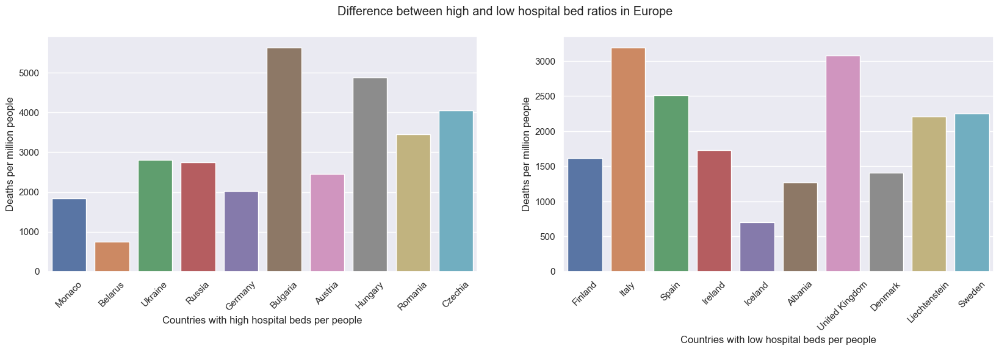

In [164]:
sns.set()
fig, ax = plt.subplots(1,2,figsize=(20,5))
high_hospital_plot= sns.barplot(
    ax=ax[0],
    data=high_hospital_data,
    x="location",
    y="total_deaths_per_million",
)
high_hospital_plot.set(xlabel="Countries with high hospital beds per people",ylabel="Deaths per million people")
low_hospital_plot=sns.barplot(
    ax=ax[1],
    data=low_hospital_data,
    x="location",
    y="total_deaths_per_million",
)
low_hospital_plot.set(xlabel="Countries with low hospital beds per people",ylabel="Deaths per million people")
plt.setp(high_hospital_plot.get_xticklabels(), rotation=45)
plt.setp(low_hospital_plot.get_xticklabels(), rotation=45)
fig.suptitle("Difference between high and low hospital bed ratios in Europe")
fig.show()

In [217]:
continent_cases = data.loc[:,["date","continent","new_cases_smoothed_per_million"]]
continent_cases["new_cases_smoothed_per_million"] = continent_cases["new_cases_smoothed_per_million"].replace(to_replace=0, method='ffill')
continent_cases = continent_cases.groupby(["date","continent"])["new_cases_smoothed_per_million"].sum().reset_index()

In [221]:

fig = px.line(continent_cases,
              x="date",
              y="new_cases_smoothed_per_million",
              color="continent",
              labels={
                     "date": "Date",
                     "new_cases_smoothed_per_million": "New cases per million people",
                     "continent": "Continents"
                 })
fig.update_layout(title="New cases in the world",
                  title_x=0.5,
                  margin={"r":10,"t":50,"l":10,"b":10})
fig.show()

In [260]:
asd = data[["date","location","continent","stringency_index","new_cases_smoothed_per_million"]]
asd = asd.loc[asd["stringency_index"].notna()].loc[asd["location"]=="Hungary"]
asd["stringency_index"] = asd["stringency_index"].replace(to_replace=0, method='ffill')


[Text(0, 0.5, 'New cases per million people')]

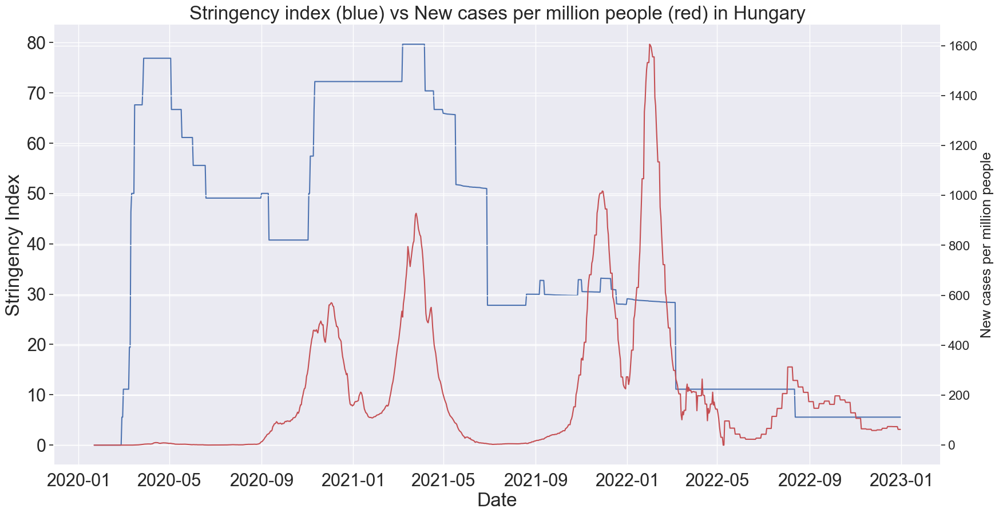

In [271]:
sns.lineplot(data=asd,x="date",y="stringency_index").set(
    title="Stringency index (blue) vs New cases per million people (red) in Hungary",
    xlabel="Date",
    ylabel="Stringency Index")
sns.set(rc={'figure.figsize':(20,10)},font_scale=1.5)
ax2 = plt.twinx()
sns.lineplot(data=asd, x="date",y="new_cases_smoothed_per_million", color="r", ax=ax2).set(ylabel="New cases per million people")



In [3]:
data_death_per_case = data[["location","continent","new_cases","new_deaths","human_development_index","hospital_beds_per_thousand"]].groupby(
    ["location","continent","human_development_index","hospital_beds_per_thousand"]).sum().reset_index()
data_death_per_case
data_death_per_case["deaths_per_100_cases"] = data_death_per_case["new_deaths"] / data_death_per_case["new_cases"] *100
fig = px.choropleth(data_death_per_case,
                     locations="location",
                     locationmode="country names",
                     color="deaths_per_100_cases",
                     color_continuous_scale="matter",
                     width=1500,height=800,
                     title="Deaths per 100 cases",
                     labels={"deaths_per_100_cases": "Deaths per 100 cases"}
                     )
#fig.show()

In [59]:
fig=px.scatter(data_death_per_case,
           y="deaths_per_100_cases",
           x='human_development_index',
           color='continent',
           height=600,
           hover_data=["location"],
           color_discrete_sequence=px.colors.qualitative.D3,
           trendline="ols")
fig.show()

In [47]:
px.scatter(data_death_per_case,
           y="deaths_per_100_cases",
           x='hospital_beds_per_thousand',
           color='continent',
           height=600,
           hover_data=["location"],
           color_discrete_sequence=px.colors.qualitative.D3)